In [23]:
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow
import os
import glob
import xml.etree.ElementTree as ET
import time

import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Activation, Dropout, Flatten, Input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow import keras

import pandas as pd
import numpy as np

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Loading Data**

In [ ]:
#train data
add = '1pe4_HgXb9dctFGJXVNlyNcKSXZeht0lX'
destination = '/content/drive/MyDrive/P2_train.zip'

!gdown https://drive.google.com/uc?id={add} -O {destination}
!unzip /content/drive/MyDrive/P2_train.zip -d /content/drive/MyDrive/train

Streaming output truncated to the last 5000 lines.
  inflating: /content/drive/MyDrive/train/test/day_08471.jpg  
  inflating: /content/drive/MyDrive/train/test/day_08471.xml  
  inflating: /content/drive/MyDrive/train/test/day_08473.jpg  
  inflating: /content/drive/MyDrive/train/test/day_08473.xml  
  inflating: /content/drive/MyDrive/train/test/day_08475.jpg  
  inflating: /content/drive/MyDrive/train/test/day_08475.xml  
  inflating: /content/drive/MyDrive/train/test/day_08477.jpg  
  inflating: /content/drive/MyDrive/train/test/day_08477.xml  
  inflating: /content/drive/MyDrive/train/test/day_08478.jpg  
  inflating: /content/drive/MyDrive/train/test/day_08478.xml  
  inflating: /content/drive/MyDrive/train/test/day_08487.jpg  
  inflating: /content/drive/MyDrive/train/test/day_08487.xml  
  inflating: /content/drive/MyDrive/train/test/day_08493.jpg  
  inflating: /content/drive/MyDrive/train/test/day_08493.xml  
  inflating: /content/drive/MyDrive/train/test/day_08494.jpg  
  in

In [ ]:
#validation data
add = '1hwz6X-Zp7JpJL35K6P3z7k6O_PTXhUcT'
destination = '/content/drive/MyDrive/P2_val.zip'

!gdown https://drive.google.com/uc?id={add} -O {destination}
!unzip /content/drive/MyDrive/P2_val.zip -d /content/drive/MyDrive/val

Archive:  /content/drive/MyDrive/P2_val.zip
   creating: /content/drive/MyDrive/val/validation/
  inflating: /content/drive/MyDrive/val/validation/day_00004.jpg  
  inflating: /content/drive/MyDrive/val/validation/day_00004.xml  
  inflating: /content/drive/MyDrive/val/validation/day_00011.jpg  
  inflating: /content/drive/MyDrive/val/validation/day_00011.xml  
  inflating: /content/drive/MyDrive/val/validation/day_00018.jpg  
  inflating: /content/drive/MyDrive/val/validation/day_00018.xml  
  inflating: /content/drive/MyDrive/val/validation/day_00024.jpg  
  inflating: /content/drive/MyDrive/val/validation/day_00024.xml  
  inflating: /content/drive/MyDrive/val/validation/day_00033.jpg  
  inflating: /content/drive/MyDrive/val/validation/day_00033.xml  
  inflating: /content/drive/MyDrive/val/validation/day_00036.jpg  
  inflating: /content/drive/MyDrive/val/validation/day_00036.xml  
  inflating: /content/drive/MyDrive/val/validation/day_00041.jpg  
  inflating: /content/drive/MyDri

In [ ]:
train_jpg = [i for i in os.listdir('/content/drive/MyDrive/train/test') if i.endswith('.jpg')]
train_xml = [i for i in os.listdir('/content/drive/MyDrive/train/test') if i.endswith('.xml')]
val_jpg = [i for i in os.listdir('/content/drive/MyDrive/val/validation/') if i.endswith('.jpg')]
val_xml = [i for i in os.listdir('/content/drive/MyDrive/val/validation/') if i.endswith('.xml')]

print(f'number of train images: {len(train_jpg)}')
print(f'number of train xml files: {len(train_xml)}')
print(f'number of val images: {len(val_jpg)}')
print(f'number of val xml files: {len(val_xml)}')

number of train images: 4176
number of train xml files: 4176
number of val images: 2120
number of val xml files: 2120


# **Displaying Samples**

images

In [ ]:
plt.figure(figsize=(10, 5))

#day
day_path = '/content/drive/MyDrive/train/test/day_16738.jpg'
day_img = cv2.imread(day_path)

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(day_img, cv2.COLOR_BGR2RGB))
plt.title('day')
plt.axis('off')

#night
night_path = '/content/drive/MyDrive/val/validation/night (970).jpg'
night_img = cv2.imread(night_path)

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(night_img, cv2.COLOR_BGR2RGB))
plt.title('night')
plt.axis('off')

plt.show()

.xml file

In [ ]:
def read_xml(file_path):
    tree = ET.parse(file_path)
    root = tree.getroot()

    for obj in root.iter('object'):
        obj_name = obj.find('name').text
        print(f"Object: {obj_name}")

        coordinates = obj.find('bndbox')
        xmin = int(coordinates.find('xmin').text)
        ymin = int(coordinates.find('ymin').text)
        xmax = int(coordinates.find('xmax').text)
        ymax = int(coordinates.find('ymax').text)
        print(f"coordinates: ({xmin}, {ymin}, {xmax}, {ymax})")

sample = '/content/drive/MyDrive/train/test/day_08473.xml'
read_xml(sample)

Object: کل ناحیه پلاک
coordinates: (114, 256, 203, 274)
Object: 3
coordinates: (123, 259, 132, 273)
Object: 2
coordinates: (132, 259, 141, 273)
Object: م
coordinates: (143, 258, 154, 273)
Object: 9
coordinates: (157, 259, 166, 272)
Object: 4
coordinates: (165, 258, 174, 272)
Object: 8
coordinates: (173, 258, 182, 272)
Object: 1
coordinates: (185, 260, 192, 271)
Object: 3
coordinates: (192, 259, 200, 271)


plate

plate coordinates = (413, 704, 820, 778)


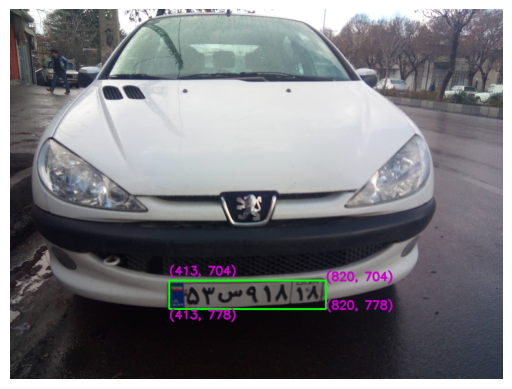

In [ ]:
tree = ET.parse('/content/drive/MyDrive/train/test/day_16168.xml')
root = tree.getroot()

for obj in root.iter('object'):
    obj_name = obj.find('name').text
    if obj_name == 'کل ناحیه پلاک':
        bndbox = obj.find('bndbox')
        xmin = int(bndbox.find('xmin').text)
        ymin = int(bndbox.find('ymin').text)
        xmax = int(bndbox.find('xmax').text)
        ymax = int(bndbox.find('ymax').text)
        coordinates = (xmin, ymin, xmax, ymax)

sample = cv2.imread('/content/drive/MyDrive/train/test/day_16168.jpg')

cv2.rectangle(sample, (coordinates[0], coordinates[1]), (coordinates[2], coordinates[3]), (0, 255, 0), 4)

font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
color = (200, 0, 200)
thickness = 3

cv2.putText(sample, f"({coordinates[0]}, {coordinates[1]})", (coordinates[0], coordinates[1]-15), font, font_scale, color, thickness)
cv2.putText(sample, f"({coordinates[2]}, {coordinates[1]})", (coordinates[2], coordinates[1]), font, font_scale, color, thickness)
cv2.putText(sample, f"({coordinates[0]}, {coordinates[3]})", (coordinates[0], coordinates[3]+25), font, font_scale, color, thickness)
cv2.putText(sample, f"({coordinates[2]}, {coordinates[3]})", (coordinates[2], coordinates[3] ), font, font_scale, color, thickness)

sample = cv2.cvtColor(sample, cv2.COLOR_BGR2RGB)

print('plate coordinates =',coordinates)
plt.imshow(sample)
plt.axis('off')
plt.show()

# **Removing Night Images**

In [ ]:
#train
train_path = '/content/drive/MyDrive/train/test/'

night_jpgs = glob.glob(os.path.join(train_path, '*night*.jpg'))
night_xmls = glob.glob(os.path.join(train_path, '*night*.xml'))

for night in night_jpgs + night_xmls:
    os.remove(night)

In [ ]:
#val
val_path = '/content/drive/MyDrive/val/validation/'

night_jpgs = glob.glob(os.path.join(val_path, '*night*.jpg'))
night_xmls = glob.glob(os.path.join(val_path, '*night*.xml'))

for night in night_jpgs + night_xmls:
    os.remove(night)

In [ ]:
train_path = '/content/drive/MyDrive/train/test/'
val_path = '/content/drive/MyDrive/val/validation/'

train_night_jpgs = glob.glob(os.path.join(train_path, '*night*.jpg'))
train_night_xmls = glob.glob(os.path.join(train_path, '*night*.xml'))

val_night_jpgs = glob.glob(os.path.join(val_path, '*night*.jpg'))
val_night_xmls = glob.glob(os.path.join(val_path, '*night*.xml'))

print('train:')
print(len(train_night_jpgs))
print(len(train_night_xmls))
print('val:')
print(len(val_night_jpgs))
print(len(val_night_xmls))

train:
0
0
val:
0
0


In [ ]:
train_jpg = [i for i in os.listdir('/content/drive/MyDrive/train/test') if i.endswith('.jpg')]
train_xml = [i for i in os.listdir('/content/drive/MyDrive/train/test') if i.endswith('.xml')]
val_jpg = [i for i in os.listdir('/content/drive/MyDrive/val/validation/') if i.endswith('.jpg')]
val_xml = [i for i in os.listdir('/content/drive/MyDrive/val/validation/') if i.endswith('.xml')]

print(f'number of train images: {len(train_jpg)}')
print(f'number of train xml files: {len(train_xml)}')
print(f'number of val images: {len(val_jpg)}')
print(f'number of val xml files: {len(val_xml)}')

number of train images: 3351
number of train xml files: 3351
number of val images: 1708
number of val xml files: 1708


# **1st Approach: YOLO**


**Converting .xml files to YOLO format .txt files**

In [ ]:
def convert_to_yolo_format(obj, img_width, img_height, class_id=0):

    coordinates = obj.find('bndbox')
    xmin = int(coordinates.find('xmin').text)
    ymin = int(coordinates.find('ymin').text)
    xmax = int(coordinates.find('xmax').text)
    ymax = int(coordinates.find('ymax').text)

    x_center = ((xmin + xmax) / 2) / img_width
    y_center = ((ymin + ymax) / 2) / img_height
    width = (xmax - xmin) / img_width
    height = (ymax - ymin) / img_height

    return f"{class_id} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}"

def plate(xml_path, img_path, output_dir):

    img = cv2.imread(img_path)
    img_height, img_width, _ = img.shape

    tree = ET.parse(xml_path)
    root = tree.getroot()

    for obj in root.iter('object'):
        name = obj.find('name').text
        if name == 'کل ناحیه پلاک':
            yolo_format = convert_to_yolo_format(obj, img_width, img_height)

            txt = os.path.basename(xml_path).replace('.xml', '.txt')
            txt_path = os.path.join(output_dir, txt)
            with open(txt_path, 'w') as f:
                f.write(yolo_format)

def loop_all_xml_files(input_dir, output_dir):
    os.makedirs(output_dir, exist_ok=True)

    for f in os.listdir(input_dir):
        if f.endswith('.xml'):
            xml_path = os.path.join(input_dir, f)
            img_path = os.path.join(input_dir, f.replace('.xml', '.jpg'))

            plate(xml_path, img_path, output_dir)

**labels directory**

In [ ]:
input = '/content/drive/MyDrive/train/test'
output = '/content/drive/MyDrive/Project2/train/labels'

loop_all_xml_files(input, output)

In [ ]:
input = '/content/drive/MyDrive/val/validation'
output = '/content/drive/MyDrive/Project2/val/labels'

loop_all_xml_files(input, output)

**images directory**

In [ ]:
import shutil

train_path = '/content/drive/MyDrive/train/test'
train_dest = '/content/drive/MyDrive/Project2/train/images'

os.makedirs(train_dest, exist_ok=True)

for f in os.listdir(train_path):
    if f.endswith('.jpg'):
        og_file = os.path.join(train_path, f)
        new_file = os.path.join(train_dest, f)

        shutil.copyfile(og_file, new_file)

In [ ]:
val_path = '/content/drive/MyDrive/val/validation'
val_dest = '/content/drive/MyDrive/Project2/val/images'

os.makedirs(val_dest, exist_ok=True)

for f in os.listdir(val_path):
    if f.endswith('.jpg'):
        og_file = os.path.join(val_path, f)
        new_file = os.path.join(val_dest, f)

        shutil.copyfile(og_file, new_file)

In [26]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 879.0/879.0 kB 22.0 MB/s eta 0:00:00


In [ ]:
train_images_path = '/content/drive/MyDrive/Project2/train/images'
train_labels_path = '/content/drive/MyDrive/Project2/train/labels'
val_images_path = '/content/drive/MyDrive/Project2/val/images'
val_labels_path = '/content/drive/MyDrive/Project2/val/labels'

yaml = f"""
train: {train_images_path}
val: {val_images_path}

nc: 1
names: ['plate']
"""
yaml_path = '/content/drive/MyDrive/Project2/data.yaml'
with open(yaml_path, 'w') as file:
    file.write(yaml)

In [27]:
from ultralytics import YOLO

# model = YOLO('yolov8m.pt')

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
!yolo train model=yolov8m.pt data='/content/drive/MyDrive/Project2/data.yaml' epochs=5 imgsz=640 batch=32 flipud=0.5 #degrees=10

Ultralytics 8.3.18 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/MyDrive/Project2/data.yaml, epochs=5, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=T

In [ ]:
model.save('/content/drive/MyDrive/Project2/plate_detection1.pt')


**validation**

In [ ]:
!yolo val model=/content/drive/MyDrive/Project2/plate_detection1.pt data='/content/drive/MyDrive/Project2/data.yaml' imgsz=640

Ultralytics 8.3.18 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/drive/MyDrive/Project2/val/labels.cache... 1708 images, 0 backgrounds, 0 corrupt: 100% 1708/1708 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 107/107 [00:56<00:00,  1.88it/s]
                   all       1708       1708      0.818      0.867      0.893      0.663
Speed: 0.3ms preprocess, 14.0ms inference, 0.0ms loss, 2.3ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


Recall = 0.867

MAP50 = 0.893

MAP50-95 = 0.663

In [ ]:
model = YOLO('/content/drive/MyDrive/Project2/plate_detection1.pt')

metrics = model.val()
print('MAP =',metrics.box.map)
print('Recall =',metrics.box.mr)

Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/drive/MyDrive/Project2/val/labels.cache... 1708 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1708/1708 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 107/107 [00:59<00:00,  1.79it/s]


                   all       1708       1708      0.818      0.867      0.893      0.663
Speed: 0.4ms preprocess, 14.5ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/val3
MAP = 0.6631331347874803
Recall = 0.867096018735363


Average IoU

In [ ]:
source = '/content/drive/MyDrive/Project2/val/images'
model=YOLO('/content/drive/MyDrive/Project2/plate_detection1.pt')

for file_name in os.listdir(source):
  img_path = os.path.join(source, file_name)
  name = os.path.splitext(file_name)[0]

  results = model.predict(source=img_path, save = True,save_txt = True, project='/content/drive/MyDrive/pred_val/', name=name, verbose=False)

Results saved to /content/drive/MyDrive/pred_val/day_06729
1 label saved to /content/drive/MyDrive/pred_val/day_06729/labels
Results saved to /content/drive/MyDrive/pred_val/day_06734
1 label saved to /content/drive/MyDrive/pred_val/day_06734/labels
Results saved to /content/drive/MyDrive/pred_val/day_06752
1 label saved to /content/drive/MyDrive/pred_val/day_06752/labels
Results saved to /content/drive/MyDrive/pred_val/day_06763
1 label saved to /content/drive/MyDrive/pred_val/day_06763/labels
Results saved to /content/drive/MyDrive/pred_val/day_06769
1 label saved to /content/drive/MyDrive/pred_val/day_06769/labels
Results saved to /content/drive/MyDrive/pred_val/day_06778
1 label saved to /content/drive/MyDrive/pred_val/day_06778/labels
Results saved to /content/drive/MyDrive/pred_val/day_06779
1 label saved to /content/drive/MyDrive/pred_val/day_06779/labels
Results saved to /content/drive/MyDrive/pred_val/day_06795
1 label saved to /content/drive/MyDrive/pred_val/day_06795/labels


In [ ]:
path = "/content/drive/MyDrive/pred_val/"
pred_val_jpg_num = len([name for name in os.listdir(path) if os.path.isdir(os.path.join(path, name))])

print(f'number of results: {pred_val_jpg_num}')

number of results: 1708


In [25]:
def plate_coordinations(file):
  tree = ET.parse(file)
  root = tree.getroot()

  for obj in root.iter('object'):
      obj_name = obj.find('name').text
      if obj_name == 'کل ناحیه پلاک':
          bndbox = obj.find('bndbox')
          xmin = int(bndbox.find('xmin').text)
          ymin = int(bndbox.find('ymin').text)
          xmax = int(bndbox.find('xmax').text)
          ymax = int(bndbox.find('ymax').text)
          coordinates = (xmin, ymin, xmax, ymax)
          return coordinates

In [ ]:
def yolo_to_pixel_plate(jpg_file,txt_file):
    image = cv2.imread(jpg_file)
    with open(txt_file, 'r') as f:
        for line in f.readlines():
            class_id, x_center, y_center, width, height = map(float, line.strip().split())

            img_height, img_width, _ = image.shape
            x_center = int(x_center * img_width)
            y_center = int(y_center * img_height)
            width = int(width * img_width)
            height = int(height * img_height)

            x1 = int(x_center - width / 2)
            y1 = int(y_center - height / 2)
            x2 = int(x_center + width / 2)
            y2 = int(y_center + height / 2)

            pixels = (x1, y1, x2, y2)
    return pixels

In [ ]:
def calculate_iou(box1, box2):
    #intersection
    w = min(box1[2], box2[2]) - max(box1[0], box2[0])
    h = min(box1[3], box2[3]) - max(box1[1], box2[1])

    if w <= 0 or h <= 0:
        return 0
    intersection_area = w * h

    #union
    actual_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    pred_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
    union_area = actual_area + pred_area - intersection_area

    iou = intersection_area / union_area
    return iou

In [ ]:
sum = 0
source = '/content/drive/MyDrive/Project2/val/images'

for file_name in os.listdir(source):
  name = os.path.splitext(file_name)[0]

  actual_xml = os.path.join('/content/drive/MyDrive/val/validation', f"{name}.xml")

  predicted_txt = os.path.join('/content/drive/MyDrive/pred_val', name, 'labels', f'{name}.txt')
  predicted_img = os.path.join('/content/drive/MyDrive/pred_val', name, f'{name}.jpg')

  actual_plate = plate_coordinations(actual_xml)
  predicted_plate = None
  if os.path.exists(predicted_txt):
    predicted_plate = yolo_to_pixel_plate(predicted_img, predicted_txt)

  if predicted_plate is None:
    iou = 0
  else:
    iou = calculate_iou(actual_plate, predicted_plate)
  sum = sum + iou

average_iou = sum / 1708
print(f"Average IoU: {average_iou}")

Average IoU: 0.6659029913062106


**Actual vs Predicted**

Results saved to /content/drive/MyDrive/predicted/day_153883
1 label saved to /content/drive/MyDrive/predicted/day_153883/labels


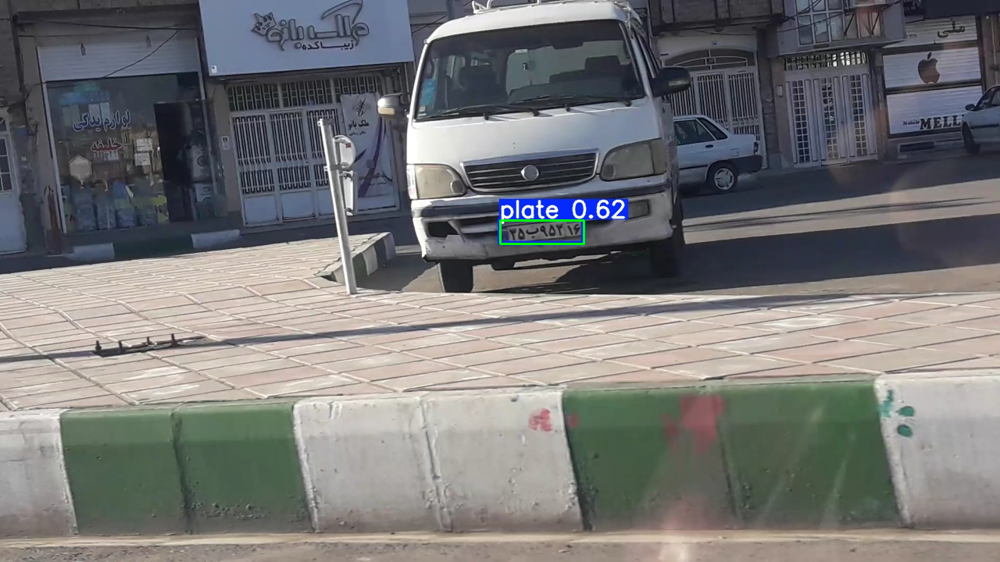

Results saved to /content/drive/MyDrive/predicted/day_00421
1 label saved to /content/drive/MyDrive/predicted/day_00421/labels


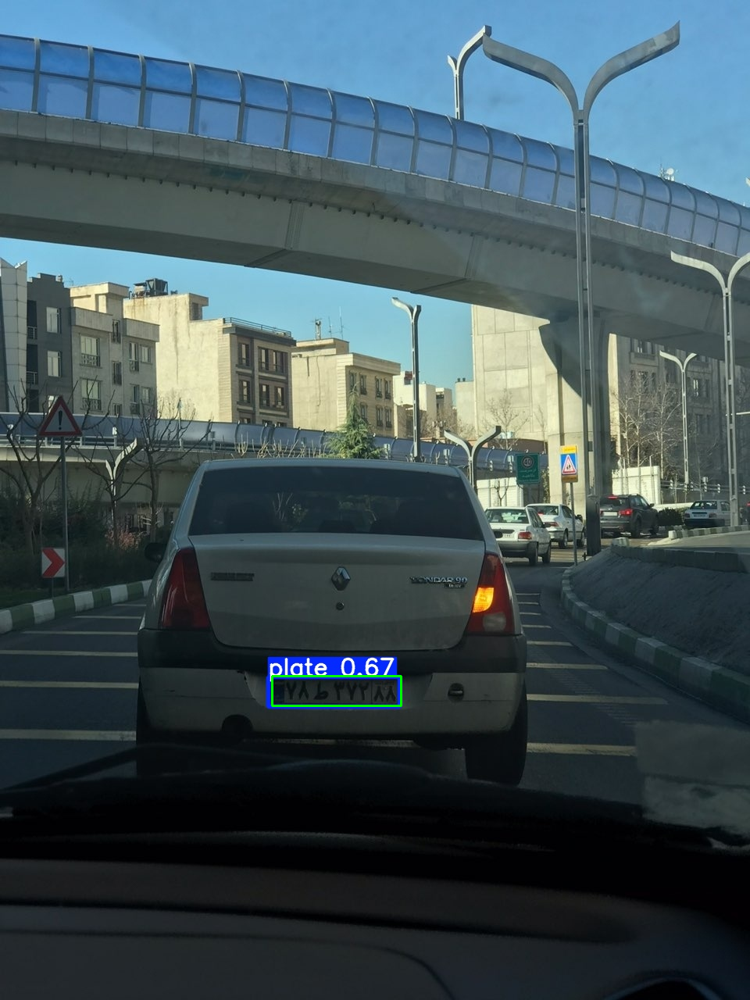

Results saved to /content/drive/MyDrive/predicted/day_01569
1 label saved to /content/drive/MyDrive/predicted/day_01569/labels


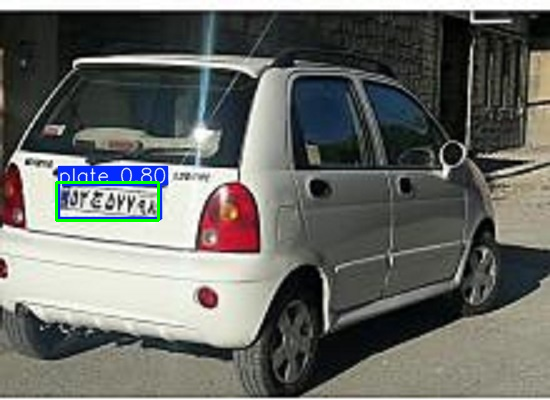

In [ ]:
samples = ['day_15388',
           'day_00421',
           'day_01569']

for sample in samples:
  img = '/content/drive/MyDrive/val/validation/' + sample +'.jpg'
  xml = '/content/drive/MyDrive/val/validation/' + sample +'.xml'
  model=YOLO('/content/drive/MyDrive/Project2/plate_detection1.pt')
  results = model.predict(source=img, save = True,save_txt = True, project='/content/drive/MyDrive/predicted/', name=sample, verbose=False)
  pred_path = os.path.join('/content/drive/MyDrive/predicted/', sample, f'{sample}.jpg')
  coordinates = plate_coordinations(xml)
  result = cv2.imread(pred_path)
  cv2.rectangle(result, (coordinates[0], coordinates[1]), (coordinates[2], coordinates[3]), (0, 255, 0), 2)
  cv2_imshow(result)

**Blurring**

In [ ]:
!yolo detect predict model=/content/drive/MyDrive/Project2/plate_detection1.pt source='/content/drive/MyDrive/my_test' save=True save_txt=True


Ultralytics 8.3.19 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 218 layers, 25,840,339 parameters, 0 gradients, 78.7 GFLOPs

image 1/6 /content/drive/MyDrive/my_test/248c29fb-f0c9-4e02-81b6-d53204640c4c.jpg: 640x480 2 plates, 1249.7ms
image 2/6 /content/drive/MyDrive/my_test/5b46bcf285a944c7a07421b259f6bd28.jpg: 320x640 1 plate, 769.8ms
image 3/6 /content/drive/MyDrive/my_test/bdf1e174-b182-48bc-a207-e3c2bc87b184.jpg: 640x480 1 plate, 1653.9ms
image 4/6 /content/drive/MyDrive/my_test/freshteh.jpg: 448x640 1 plate, 1693.7ms
image 5/6 /content/drive/MyDrive/my_test/pasdaran3.jpg: 448x640 1 plate, 1152.8ms
image 6/6 /content/drive/MyDrive/my_test/خودرو+لاماری.jpg: 448x640 1 plate, 1046.2ms
Speed: 3.9ms preprocess, 1261.0ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict3
6 labels saved to runs/detect/predict3/labels
💡 Learn more at https://docs.ultralytics.com/modes/predict


In [24]:
def blur_plates(image_path, pixels):
  x1, y1, x2, y2 = pixels
  im = cv2.imread(image_path)

  plate = im[y1:y2, x1:x2]
  blurred_plate = cv2.GaussianBlur(plate, (51, 51), 30)

  im[y1:y2, x1:x2] = blurred_plate

  return im

Results saved to /content/drive/MyDrive/my_test/predictions/خودرو+لاماری
1 label saved to /content/drive/MyDrive/my_test/predictions/خودرو+لاماری/labels


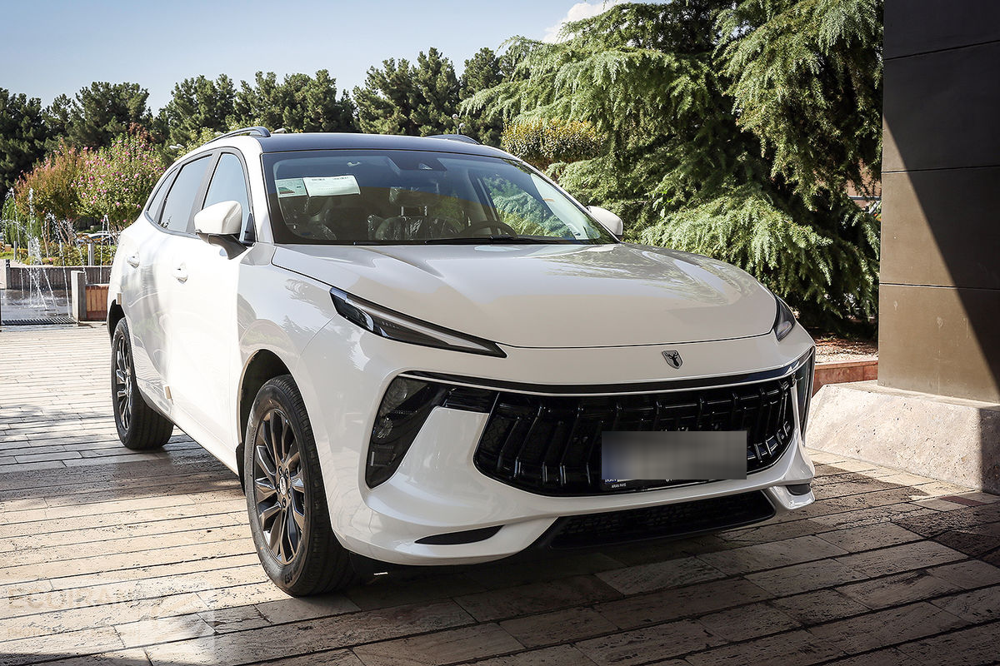

overal time: 1.970533847808838
Results saved to /content/drive/MyDrive/my_test/predictions/5b46bcf285a944c7a07421b259f6bd28
1 label saved to /content/drive/MyDrive/my_test/predictions/5b46bcf285a944c7a07421b259f6bd28/labels


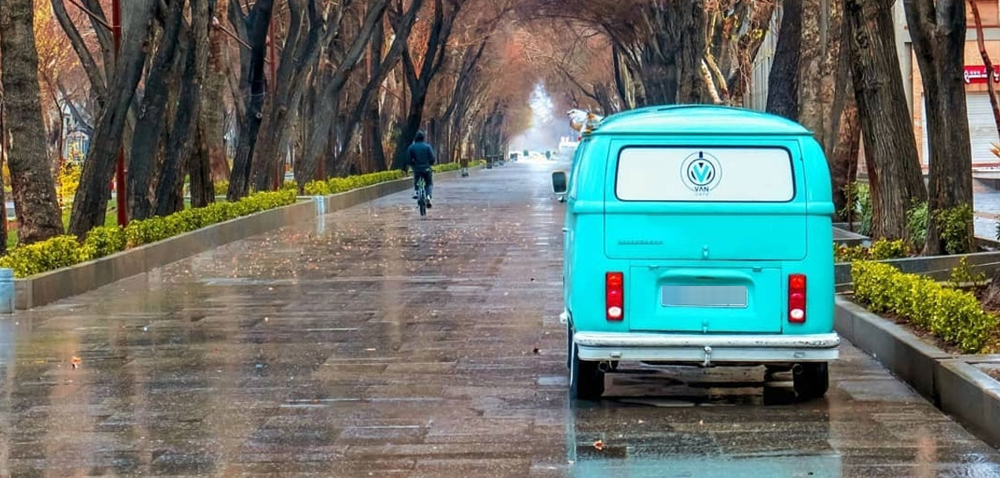

overal time: 1.3909118175506592
Results saved to /content/drive/MyDrive/my_test/predictions/freshteh
1 label saved to /content/drive/MyDrive/my_test/predictions/freshteh/labels


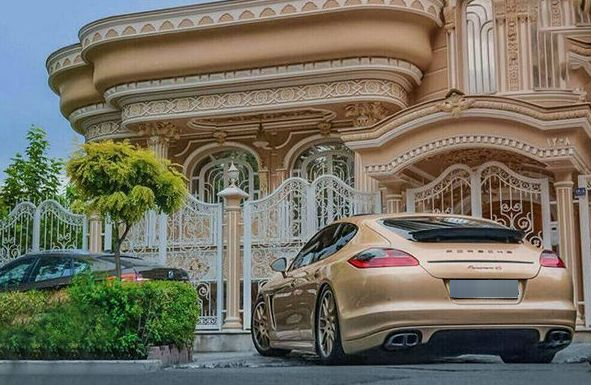

overal time: 1.9455392360687256
Results saved to /content/drive/MyDrive/my_test/predictions/pasdaran3
1 label saved to /content/drive/MyDrive/my_test/predictions/pasdaran3/labels


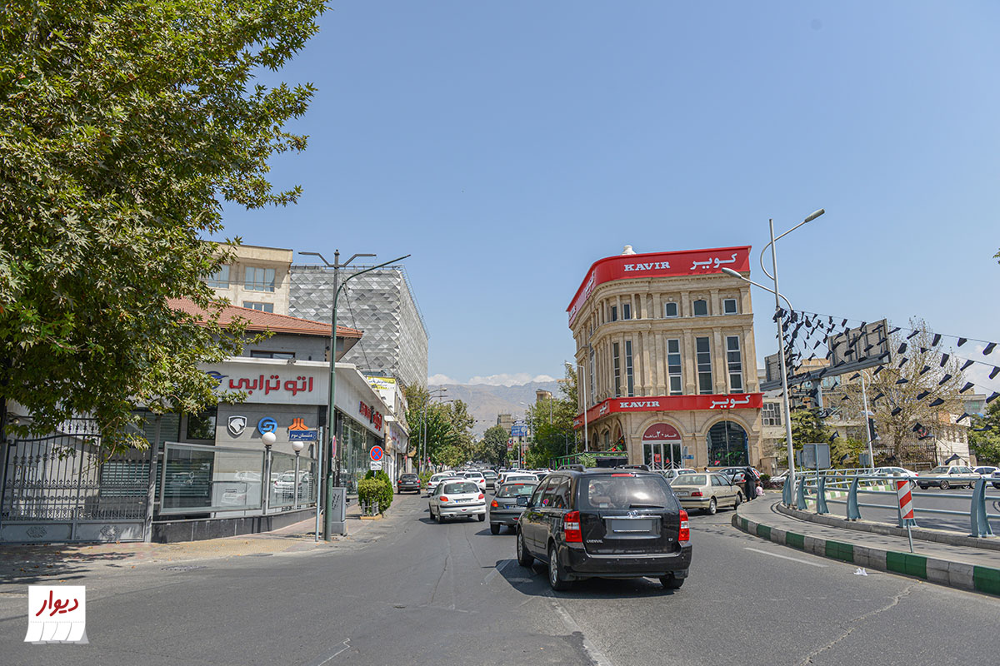

overal time: 2.183657646179199
Results saved to /content/drive/MyDrive/my_test/predictions/248c29fb-f0c9-4e02-81b6-d53204640c4c
1 label saved to /content/drive/MyDrive/my_test/predictions/248c29fb-f0c9-4e02-81b6-d53204640c4c/labels


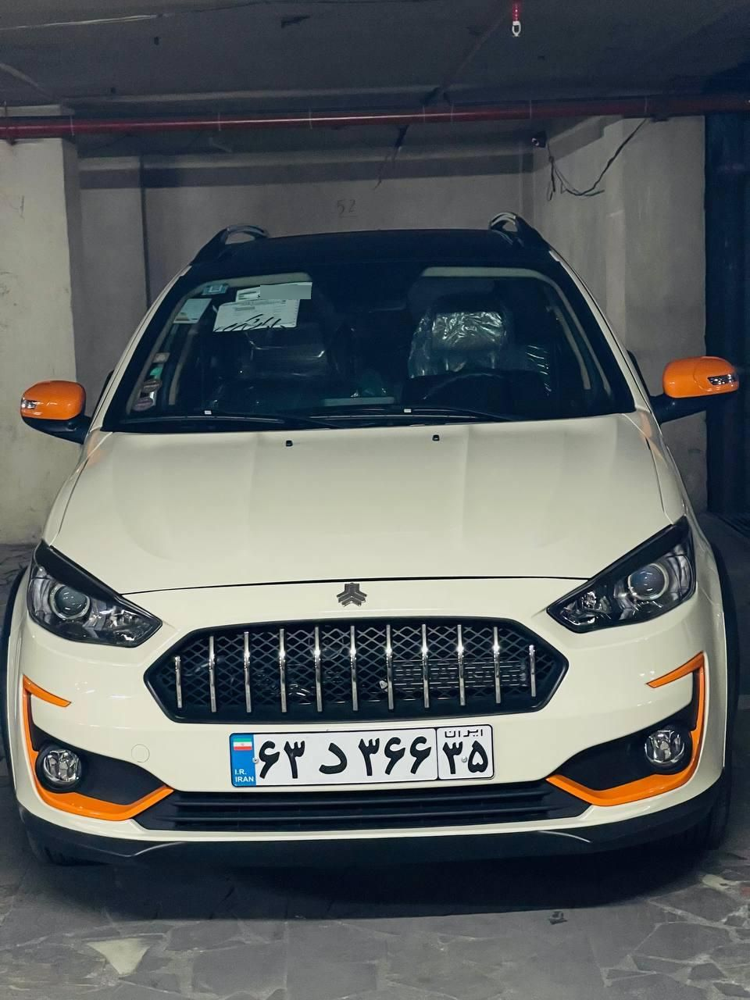

overal time: 2.4689974784851074
Results saved to /content/drive/MyDrive/my_test/predictions/bdf1e174-b182-48bc-a207-e3c2bc87b184
1 label saved to /content/drive/MyDrive/my_test/predictions/bdf1e174-b182-48bc-a207-e3c2bc87b184/labels


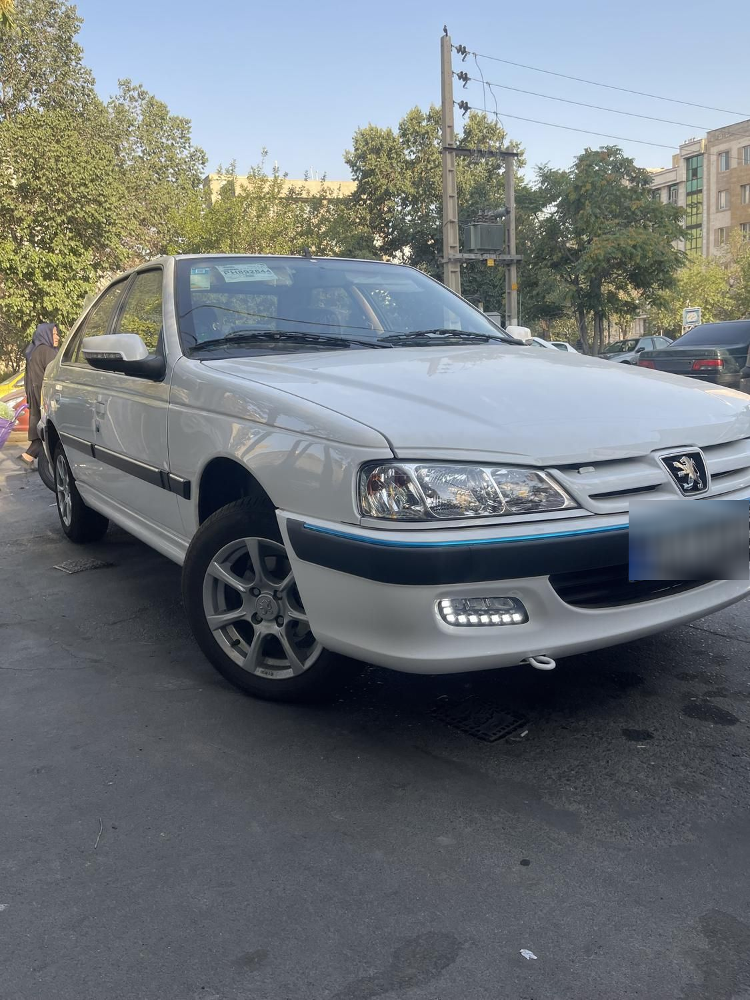

overal time: 1.8828043937683105


In [ ]:
directory_path = '/content/drive/MyDrive/my_test'
model=YOLO('/content/drive/MyDrive/Project2/plate_detection1.pt')

for file_name in os.listdir(directory_path):
  name = os.path.splitext(file_name)[0]
  file_path = os.path.join(directory_path, file_name)
  start_time = time.time()
  results = model.predict(source=file_path, save = True,save_txt = True, project='/content/drive/MyDrive/my_test/predictions', name=name, verbose=False)
  img_pred_path = os.path.join('/content/drive/MyDrive/my_test/predictions', name, file_name)
  label_path = os.path.join('/content/drive/MyDrive/my_test/predictions', name,'labels', file_name.replace('.jpg', '.txt'))
  pixels = yolo_to_pixel_plate(img_pred_path, label_path)
  result = blur_plates(file_path, pixels)
  cv2_imshow(result)
  end_time = time.time()
  process_time = end_time - start_time
  print('overal time:', process_time)


# **Second Try**

In [ ]:
from ultralytics import YOLO

model = YOLO('yolov9m.pt')

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 39.1M/39.1M [00:00<00:00, 135MB/s]


In [ ]:
results = model.train(data="/content/drive/MyDrive/Project2/data.yaml",
                      epochs=10, imgsz=512,
                      project = '/content/drive/MyDrive/secondtry', box = 8,
                      batch=16, flipud=0.5)

Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov9m.pt, data=/content/drive/MyDrive/Project2/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/secondtry, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, 

train: Scanning /content/drive/MyDrive/Project2/train/labels.cache... 3351 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3351/3351 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/Project2/val/labels.cache... 1708 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1708/1708 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/secondtry/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 149 weight(decay=0.0), 156 weight(decay=0.0005), 155 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/secondtry/train3
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      5.76G      1.354      1.339      1.141          7        512: 100%|██████████| 210/210 [02:44<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [06:18<00:00,  7.01s/it]


                   all       1708       1708      0.662      0.624       0.68       0.41

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      5.72G      1.453      1.015      1.194          7        512: 100%|██████████| 210/210 [02:15<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:41<00:00,  1.29it/s]


                   all       1708       1708      0.767      0.722      0.757      0.457

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      5.64G       1.39     0.9435      1.175          7        512: 100%|██████████| 210/210 [02:12<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:39<00:00,  1.38it/s]

                   all       1708       1708      0.755      0.763      0.795      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      5.75G      1.332     0.8812      1.143          7        512: 100%|██████████| 210/210 [02:11<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:41<00:00,  1.29it/s]


                   all       1708       1708      0.797      0.779      0.813      0.499

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      5.69G      1.244     0.7811      1.099          7        512: 100%|██████████| 210/210 [02:11<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:42<00:00,  1.27it/s]

                   all       1708       1708      0.782      0.844      0.843      0.558



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      5.71G      1.161     0.7286      1.061          7        512: 100%|██████████| 210/210 [02:13<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:39<00:00,  1.35it/s]


                   all       1708       1708      0.829      0.838      0.864      0.591

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      5.73G      1.101     0.6929      1.041          7        512: 100%|██████████| 210/210 [02:11<00:00,  1.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:43<00:00,  1.25it/s]

                   all       1708       1708      0.818      0.867      0.876      0.622



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10       5.7G      1.064     0.6471      1.026         15        512:  72%|███████▏  | 152/210 [21:38<08:15,  8.54s/it]


KeyboardInterrupt: 

In [ ]:
model = YOLO("/content/drive/MyDrive/secondtry/train3/weights/last.pt")

results = model.train(resume=True)


Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/secondtry/train3/weights/last.pt, data=/content/drive/MyDrive/Project2/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/secondtry, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=/content/drive/MyDrive/secondtry/train3/weights/last.pt, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False

train: Scanning /content/drive/MyDrive/Project2/train/labels.cache... 3351 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3351/3351 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/Project2/val/labels.cache... 1708 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1708/1708 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/secondtry/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 149 weight(decay=0.0), 156 weight(decay=0.0005), 155 bias(decay=0.0)
Resuming training /content/drive/MyDrive/secondtry/train3/weights/last.pt from epoch 8 to 10 total epochs
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/secondtry/train3
Starting training for 10 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      6.08G       1.13      0.844      1.036         15        512: 100%|██████████| 210/210 [02:31<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:39<00:00,  1.37it/s]

                   all       1708       1708      0.826       0.87      0.881      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      6.11G      1.061     0.6303      1.027         10        512: 100%|██████████| 210/210 [02:09<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:39<00:00,  1.38it/s]

                   all       1708       1708      0.826       0.87      0.887      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      6.09G      1.004     0.5804     0.9966         14        512: 100%|██████████| 210/210 [02:08<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:39<00:00,  1.38it/s]


                   all       1708       1708      0.824       0.88      0.888      0.672

3 epochs completed in 0.152 hours.
Optimizer stripped from /content/drive/MyDrive/secondtry/train3/weights/last.pt, 40.8MB
Optimizer stripped from /content/drive/MyDrive/secondtry/train3/weights/best.pt, 40.8MB

Validating /content/drive/MyDrive/secondtry/train3/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv9m summary (fused): 374 layers, 20,013,715 parameters, 0 gradients, 76.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:42<00:00,  1.28it/s]


                   all       1708       1708      0.824       0.88      0.888      0.672
Speed: 0.1ms preprocess, 6.0ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to /content/drive/MyDrive/secondtry/train3


In [ ]:
model = YOLO("/content/drive/MyDrive/secondtry/train3/weights/last.pt")
results = model.train(data="/content/drive/MyDrive/Project2/data.yaml",
                      epochs=5, imgsz=512,
                      project = '/content/drive/MyDrive/secondtry', box = 8,
                      batch=32, flipud=0.3)

Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/secondtry/train3/weights/last.pt, data=/content/drive/MyDrive/Project2/data.yaml, epochs=5, time=None, patience=100, batch=32, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/secondtry, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_t

train: Scanning /content/drive/MyDrive/Project2/train/labels.cache... 3351 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3351/3351 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/Project2/val/labels.cache... 1708 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1708/1708 [00:00<?, ?it/s]


Plotting labels to /content/drive/MyDrive/secondtry/train4/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 149 weight(decay=0.0), 156 weight(decay=0.0005), 155 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/secondtry/train4
Starting training for 5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5      11.4G      1.027     0.6089     0.9986         50        512: 100%|██████████| 105/105 [02:06<00:00,  1.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:38<00:00,  1.43s/it]

                   all       1708       1708      0.584      0.109      0.151      0.105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5      11.2G      1.105      0.666      1.032         41        512: 100%|██████████| 105/105 [02:06<00:00,  1.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:39<00:00,  1.46s/it]

                   all       1708       1708       0.81      0.857      0.862      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5      11.2G      1.074     0.6445      1.022         40        512: 100%|██████████| 105/105 [02:06<00:00,  1.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:39<00:00,  1.46s/it]

                   all       1708       1708      0.802       0.86      0.862      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5      11.2G       1.08     0.6192      1.029         43        512: 100%|██████████| 105/105 [02:05<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:39<00:00,  1.48s/it]

                   all       1708       1708      0.834      0.836      0.881       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5      11.2G      1.021     0.5937      1.004         38        512: 100%|██████████| 105/105 [02:07<00:00,  1.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:53<00:00,  1.99s/it]

                   all       1708       1708      0.825       0.87      0.888      0.667



5 epochs completed in 0.249 hours.
Optimizer stripped from /content/drive/MyDrive/secondtry/train4/weights/last.pt, 40.8MB
Optimizer stripped from /content/drive/MyDrive/secondtry/train4/weights/best.pt, 40.8MB

Validating /content/drive/MyDrive/secondtry/train4/weights/best.pt...
Ultralytics 8.3.23 🚀 Python-3.10.12 torch-2.5.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv9m summary (fused): 374 layers, 20,013,715 parameters, 0 gradients, 76.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 27/27 [00:41<00:00,  1.52s/it]


                   all       1708       1708      0.825       0.87      0.888      0.667
Speed: 0.1ms preprocess, 6.1ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to /content/drive/MyDrive/secondtry/train4


In [ ]:
source = '/content/drive/MyDrive/Project2/val/images'
model=YOLO('/content/drive/MyDrive/secondtry/train3/weights/best.pt')

for file_name in os.listdir(source):
  img_path = os.path.join(source, file_name)
  name = os.path.splitext(file_name)[0]
  # xml_path = file_name +'.xml'

  results = model.predict(source=img_path, save = True,save_txt = True, project='/content/drive/MyDrive/secondtry/pred_val/', name=name, verbose=False)

Results saved to /content/drive/MyDrive/secondtry/pred_val/day_06729
1 label saved to /content/drive/MyDrive/secondtry/pred_val/day_06729/labels
Results saved to /content/drive/MyDrive/secondtry/pred_val/day_06734
1 label saved to /content/drive/MyDrive/secondtry/pred_val/day_06734/labels
Results saved to /content/drive/MyDrive/secondtry/pred_val/day_06752
1 label saved to /content/drive/MyDrive/secondtry/pred_val/day_06752/labels
Results saved to /content/drive/MyDrive/secondtry/pred_val/day_06763
1 label saved to /content/drive/MyDrive/secondtry/pred_val/day_06763/labels
Results saved to /content/drive/MyDrive/secondtry/pred_val/day_06769
1 label saved to /content/drive/MyDrive/secondtry/pred_val/day_06769/labels
Results saved to /content/drive/MyDrive/secondtry/pred_val/day_06778
1 label saved to /content/drive/MyDrive/secondtry/pred_val/day_06778/labels
Results saved to /content/drive/MyDrive/secondtry/pred_val/day_06779
1 label saved to /content/drive/MyDrive/secondtry/pred_val/da

In [ ]:
sum = 0
source = '/content/drive/MyDrive/Project2/val/images'

for file_name in os.listdir(source):
  name = os.path.splitext(file_name)[0]

  actual_xml = os.path.join('/content/drive/MyDrive/val/validation', f"{name}.xml")

  predicted_txt = os.path.join('/content/drive/MyDrive/secondtry/pred_val', name, 'labels', f'{name}.txt')
  predicted_img = os.path.join('/content/drive/MyDrive/secondtry/pred_val', name, f'{name}.jpg')

  actual_plate = plate_coordinations(actual_xml)
  predicted_plate = None
  if os.path.exists(predicted_txt):
    predicted_plate = yolo_to_pixel_plate(predicted_img, predicted_txt)

  if predicted_plate is None:
    iou = 0
  else:
    iou = calculate_iou(actual_plate, predicted_plate)
  sum = sum + iou

average_iou = sum / 1708
print(f"Average IoU: {average_iou}")

Average IoU: 0.6886441228672842


Results saved to /content/drive/MyDrive/my_test/predictions/خودرو+لاماری2
1 label saved to /content/drive/MyDrive/my_test/predictions/خودرو+لاماری2/labels


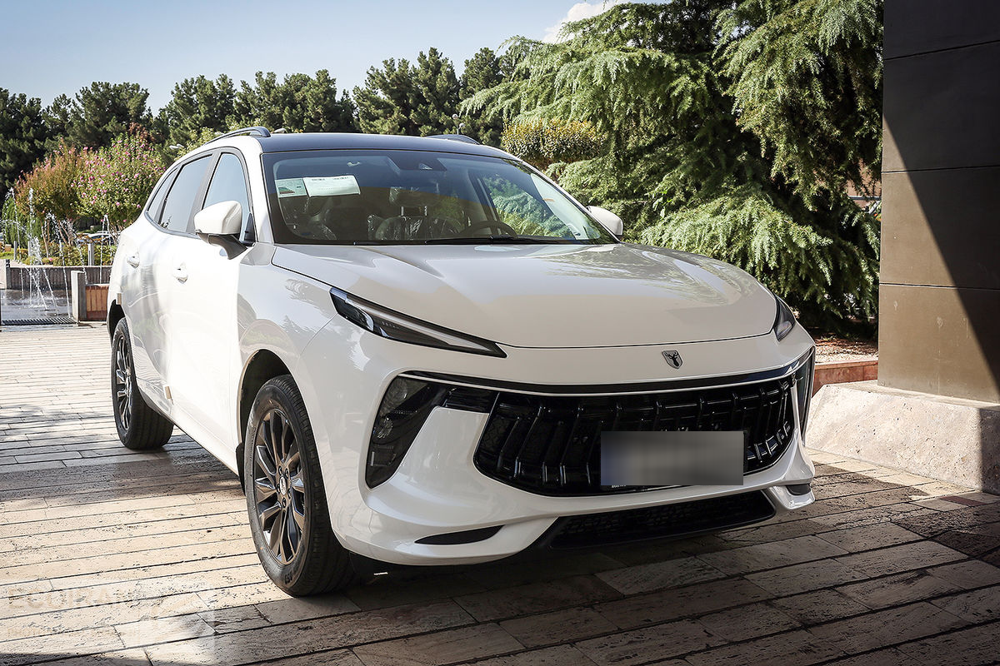

overal time: 2.4892334938049316
Results saved to /content/drive/MyDrive/my_test/predictions/5b46bcf285a944c7a07421b259f6bd282
1 label saved to /content/drive/MyDrive/my_test/predictions/5b46bcf285a944c7a07421b259f6bd282/labels


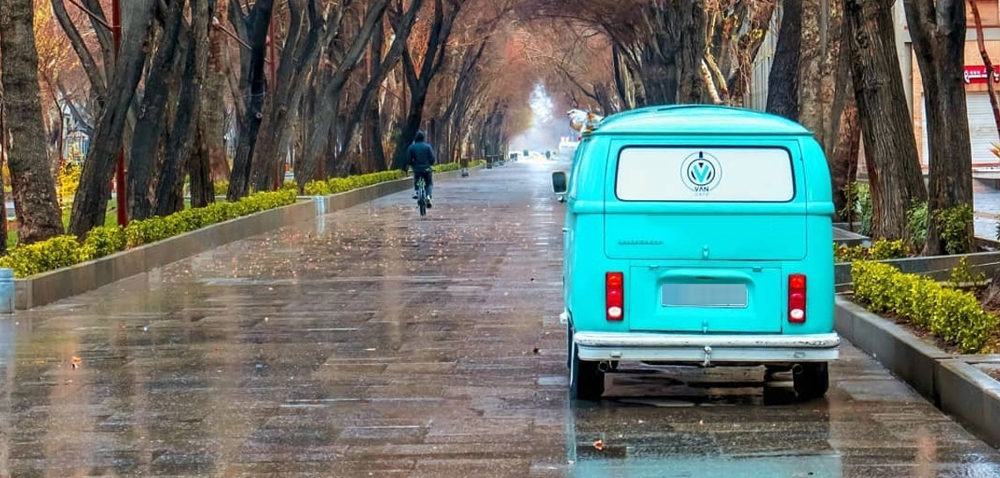

overal time: 2.2137129306793213
Results saved to /content/drive/MyDrive/my_test/predictions/freshteh2
1 label saved to /content/drive/MyDrive/my_test/predictions/freshteh2/labels


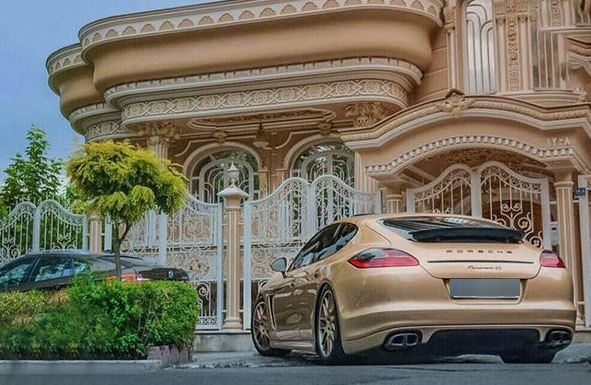

overal time: 2.2366812229156494
Results saved to /content/drive/MyDrive/my_test/predictions/pasdaran32
1 label saved to /content/drive/MyDrive/my_test/predictions/pasdaran32/labels


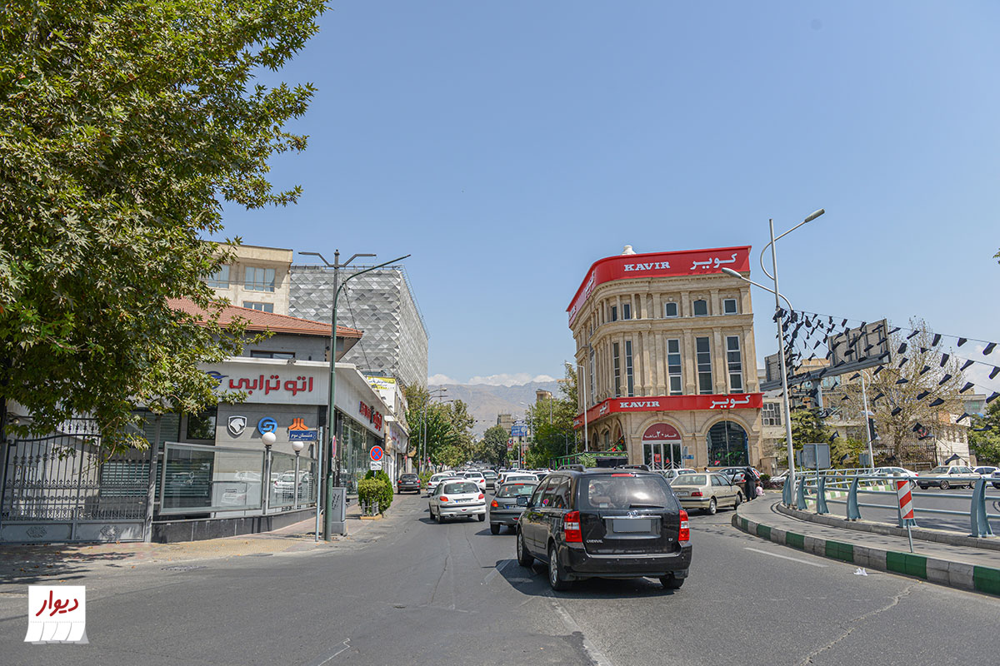

overal time: 2.710904598236084
Results saved to /content/drive/MyDrive/my_test/predictions/248c29fb-f0c9-4e02-81b6-d53204640c4c2
1 label saved to /content/drive/MyDrive/my_test/predictions/248c29fb-f0c9-4e02-81b6-d53204640c4c2/labels


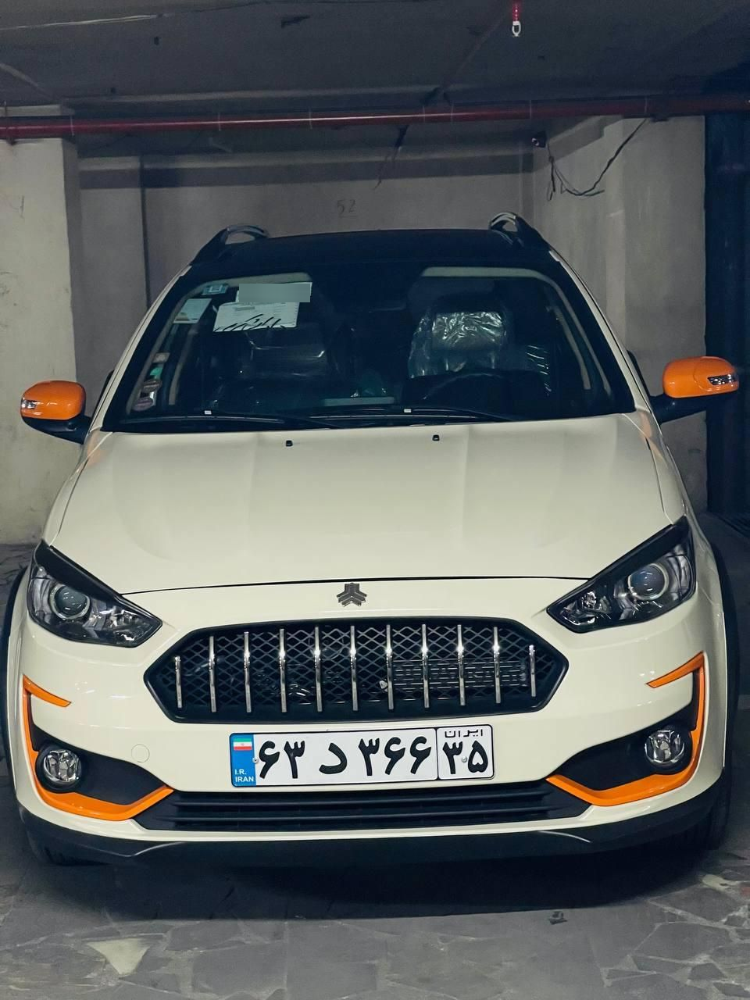

overal time: 2.451249599456787
Results saved to /content/drive/MyDrive/my_test/predictions/bdf1e174-b182-48bc-a207-e3c2bc87b1842
1 label saved to /content/drive/MyDrive/my_test/predictions/bdf1e174-b182-48bc-a207-e3c2bc87b1842/labels


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/my_test/predictions/bdf1e174-b182-48bc-a207-e3c2bc87b184/labels/bdf1e174-b182-48bc-a207-e3c2bc87b184.txt'

In [ ]:
directory_path = '/content/drive/MyDrive/my_test'
model=YOLO('/content/drive/MyDrive/secondtry/train3/weights/best.pt')

for file_name in os.listdir(directory_path):
  name = os.path.splitext(file_name)[0]
  file_path = os.path.join(directory_path, file_name)
  start_time = time.time()
  results = model.predict(source=file_path, save = True,save_txt = True, project='/content/drive/MyDrive/my_test/predictions', name=name, verbose=False)
  img_pred_path = os.path.join('/content/drive/MyDrive/my_test/predictions', name, file_name)
  label_path = os.path.join('/content/drive/MyDrive/my_test/predictions', name,'labels', file_name.replace('.jpg', '.txt'))
  pixels = yolo_to_pixel_plate(img_pred_path, label_path)
  result = blur_plates(file_path, pixels)
  cv2_imshow(result)
  end_time = time.time()
  process_time = end_time - start_time
  print('overal time:', process_time)

# **2nd Approach: Inception_Resnet**

**preparing data**



In [ ]:
train_path = '/content/drive/MyDrive/train/test'
im = []
plate = []

for file in os.listdir(train_path):
    if file.endswith('.jpg'):
        image_path = os.path.join(train_path, file)
        xml_path = os.path.join(train_path, file.replace('.jpg', '.xml'))

        image = cv2.imread(image_path)
        h, w, _ = image.shape

        resized = load_img(image_path, target_size=(224, 224))
        arr = img_to_array(resized)
        normalized = arr / 255.0
        im.append(normalized)

        coordinates = plate_coordinations(xml_path)
        if coordinates:
            xmin, ymin, xmax, ymax = coordinates
            xmin, xmax = xmin / w, xmax / w
            ymin, ymax = ymin / h, ymax / h

            label = (xmin, ymin, xmax, ymax)
            plate.append(label)

In [ ]:
np.save('/content/drive/MyDrive/Project2/im.npy', im)
np.save('/content/drive/MyDrive/Project2/plate.npy', plate)

In [ ]:
val_path = '/content/drive/MyDrive/val/validation'
val_im = []
val_plate = []

for file in os.listdir(val_path):
    if file.endswith('.jpg'):
        image_path = os.path.join(val_path, file)
        xml_path = os.path.join(val_path, file.replace('.jpg', '.xml'))

        image = cv2.imread(image_path)
        h, w, _ = image.shape

        resized = load_img(image_path, target_size=(224, 224))
        arr = img_to_array(resized)
        normalized = arr / 255.0
        val_im.append(normalized)

        coordinates = plate_coordinations(xml_path)
        if coordinates:
            xmin, ymin, xmax, ymax = coordinates
            xmin, xmax = xmin / w, xmax / w
            ymin, ymax = ymin / h, ymax / h

            label = (xmin, ymin, xmax, ymax)
            val_plate.append(label)

In [ ]:
np.save('/content/drive/MyDrive/valim.npy', val_im)
np.save('/content/drive/MyDrive/valplate.npy', val_plate)

In [ ]:
train_path = '/content/drive/MyDrive/train/test'
val_path = '/content/drive/MyDrive/val/validation'

def load_image_and_label(image_path, xml_path):

    image = load_img(image_path, target_size=(224, 224))
    image_array = img_to_array(image) / 255.0

    coordinates = plate_coordinations(xml_path)
    if coordinates:
        h, w, _ = cv2.imread(image_path).shape
        xmin, ymin, xmax, ymax = coordinates
        xmin, xmax = xmin / w, xmax / w
        ymin, ymax = ymin / h, ymax / h
        label_norm = (nxmin, nymin, nxmax, nymax)

    return image_array, label_norm


def data_generator(path):
    for file in os.listdir(path):
        if file.endswith('.jpg'):
            image_path = os.path.join(path, file)
            xml_path = os.path.join(path, file.replace('.jpg', '.xml'))
            yield load_image_and_label(image_path, xml_path)


train_ds = tf.data.Dataset.from_generator(lambda: data_generator(train_path),
                                          output_signature=(tf.TensorSpec(shape=(224, 224, 3), dtype=tf.float32),
                                                            tf.TensorSpec(shape=(4,), dtype=tf.float32))
                                          ).batch(64).prefetch(tf.data.AUTOTUNE)

val_ds = tf.data.Dataset.from_generator(lambda: data_generator(val_path),
                                          output_signature=(tf.TensorSpec(shape=(224, 224, 3), dtype=tf.float32),
                                                            tf.TensorSpec(shape=(4,), dtype=tf.float32))
                                          ).batch(64).prefetch(tf.data.AUTOTUNE)

In [ ]:
train_ds = tf.data.Dataset.from_tensor_slices((X_train, y_train)).batch(10).prefetch(tf.data.AUTOTUNE)
val_ds = tf.data.Dataset.from_tensor_slices((X_val, y_val)).batch(10).prefetch(tf.data.AUTOTUNE)

In [ ]:
im = np.load('/content/drive/MyDrive/im.npy')
plate = np.load('/content/drive/MyDrive/plate.npy')

In [ ]:
X_train = np.array(im, dtype=np.float32)
y_train = np.array(plate, dtype=np.float32)

X_val = np.array(val_im, dtype=np.float32)
y_val = np.array(val_plate, dtype=np.float32)

**Model**

In [ ]:
from keras.applications import InceptionResNetV2

model = Sequential()

base_model = InceptionResNetV2(include_top=False, weights="imagenet", input_shape=(224, 224, 3))

for layer in base_model.layers:
    layer.trainable = False

model.add(base_model)
model.add(Flatten())
model.add(Dense(512, activation="relu"))
model.add(Dense(256, activation="relu"))
model.add(Dense(4, activation="sigmoid"))

for layer in base_model.layers[-5:]:
    layer.trainable = True

In [ ]:
model.compile(loss="mse", optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001))

In [ ]:
history = model.fit(train_ds, epochs=6, steps_per_epoch=train_steps,
                    validation_data=val_ds, validation_steps=val_steps)

__________________________________

**second try**

In [ ]:
X = np.array(im, dtype=np.float32)
y = np.array(plate, dtype=np.float32)

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=0)

In [ ]:
from keras.applications import InceptionResNetV2

model = Sequential()
base_model = InceptionResNetV2(include_top=False, weights="imagenet", input_shape=(224, 224, 3))
base_model.trainable = False

model.add(base_model)
model.add(Flatten())
model.add(Dense(512, activation="relu"))
model.add(Dense(256, activation="relu"))
model.add(Dense(4, activation="sigmoid"))

In [ ]:
model.compile(loss="mse", optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001))

In [ ]:
model.save('/content/drive/MyDrive/Project2/plate_ir.h5')

In [ ]:
model = tf.keras.models.load_model("/content/drive/MyDrive/Project2/plate_ir.h5")

In [ ]:
history = model.fit(x=X_train, y=y_train, batch_size=10,
                    epochs=5, validation_data=(X_test, y_test))

Epoch 1/5
268/268 ━━━━━━━━━━━━━━━━━━━━ 71s 146ms/step - loss: 0.0871 - val_loss: 0.0187
Epoch 2/5
268/268 ━━━━━━━━━━━━━━━━━━━━ 52s 83ms/step - loss: 0.0151 - val_loss: 0.0163
Epoch 3/5
268/268 ━━━━━━━━━━━━━━━━━━━━ 21s 79ms/step - loss: 0.0091 - val_loss: 0.0141
Epoch 4/5
268/268 ━━━━━━━━━━━━━━━━━━━━ 23s 85ms/step - loss: 0.0061 - val_loss: 0.0137
Epoch 5/5
268/268 ━━━━━━━━━━━━━━━━━━━━ 21s 80ms/step - loss: 0.0053 - val_loss: 0.0133


In [ ]:
history = model.fit(x=X_train, y=y_train, batch_size=10,
                    epochs=10, validation_data=(X_test, y_test))

Epoch 1/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 105s 146ms/step - loss: 0.1124 - val_loss: 0.0384
Epoch 2/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 22s 82ms/step - loss: 0.0188 - val_loss: 0.0138
Epoch 3/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 41s 83ms/step - loss: 0.0087 - val_loss: 0.0129
Epoch 4/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 41s 85ms/step - loss: 0.0065 - val_loss: 0.0129
Epoch 5/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 42s 88ms/step - loss: 0.0048 - val_loss: 0.0126
Epoch 6/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 38s 78ms/step - loss: 0.0039 - val_loss: 0.0119
Epoch 7/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 42s 82ms/step - loss: 0.0028 - val_loss: 0.0120
Epoch 8/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 40s 78ms/step - loss: 0.0026 - val_loss: 0.0119
Epoch 9/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 44s 87ms/step - loss: 0.0022 - val_loss: 0.0122
Epoch 10/10
268/268 ━━━━━━━━━━━━━━━━━━━━ 39s 79ms/step - loss: 0.0019 - val_loss: 0.0114


# **Conclusion**

**YOLO**


*   recall = 0.88
*   map50 = 0.88
*   map50-95 = 0.67
*   average iou = 0.68

**Inception-ResNet-v2**


*   resource intensive

**haar cascades**


*   high false positives

**contouring**


*   ineffective in complex backgrounds

In [28]:
def yolo_to_pixel_plate(jpg_file, txt_file):
    image = cv2.imread(jpg_file)
    img_height, img_width, _ = image.shape
    pixels = []

    with open(txt_file, 'r') as f:
        for line in f.readlines():
            class_id, x_center, y_center, width, height = map(float, line.strip().split())

            x_center = int(x_center * img_width)
            y_center = int(y_center * img_height)
            width = int(width * img_width)
            height = int(height * img_height)

            x1 = int(x_center - width / 2)
            y1 = int(y_center - height / 2)
            x2 = int(x_center + width / 2)
            y2 = int(y_center + height / 2)

            pixels.append((x1, y1, x2, y2))

    return pixels

In [29]:
def blur_plates(image, pixels):
  x1, y1, x2, y2 = pixels
  # im = cv2.imread(image_path)

  plate = image[y1:y2, x1:x2]
  blurred_plate = cv2.GaussianBlur(plate, (51, 51), 30)

  image[y1:y2, x1:x2] = blurred_plate

  return im

In [ ]:
avg_time = sum/30
avg_time

3.8064906438191732